In [1]:
import json
from drug_utils import DataHandler
# Load the data from JSON
with open('interactions.json', 'r') as file:
    interactions_data = json.load(file)



In [2]:
import networkx as nx

# Initialize a directed graph
G = nx.DiGraph()

# Scaling factor for edge weights
edge_scaling_factor = 1  # Adjust as needed

# Scaling factor for node weights
node_scaling_factor = 100  # Adjust as needed

# Iterate over the interaction data to add nodes and weighted edges
for drug_data in interactions_data:
    drug = drug_data['name']
    #popularity_weight = calculate_popularity_weight(drug) * node_scaling_factor  # Calculate popularity weight and scale it

    G.add_node(drug)  # Add the drug as a node with scaled popularity weight

    # Add weighted edges for each type of interaction
    # Assuming major interactions are more significant
    for interaction in drug_data['major_interactions']:
        G.add_edge(drug, interaction, weight=3 * edge_scaling_factor)  # Scale edge weight for major interactions
    for interaction in drug_data['minor_interactions']:
        G.add_edge(drug, interaction, weight= 1*edge_scaling_factor)  # Scale edge weight for minor interactions
    for interaction in drug_data['moderate_interactions']:
        G.add_edge(drug, interaction, weight=2* edge_scaling_factor)  # Scale edge weight for moderate interactions



In [ ]:
# Compute PageRank considering the weights
pagerank_scores = nx.pagerank(G, weight='weight')

# Now pagerank_scores will be based on the type and significance of interactions
sorted_pagerank = sorted(pagerank_scores.items(), key=lambda x: x[1], reverse=True)
sorted_pagerank 


In [ ]:
# Sort the drugs based on their PageRank scores
sorted_pagerank = sorted(pagerank_scores.items(), key=lambda x: x[1], reverse=True)

# `sorted_pagerank` is now a list of tuples where each tuple is (drug_name, pagerank_score),
# sorted from the highest to the lowest score.
sorted_pagerank 

In [ ]:
scaling_factor = 1000  # Adjust as needed
sorted_pagerank_dict = dict(sorted_pagerank)

# Multiply the PageRank scores by a scaling factor to make them larger
scaling_factor = 1000  # Adjust as needed
scaled_pagerank_scores = {node: score * scaling_factor for node, score in sorted_pagerank_dict.items()}
scaled_pagerank_scores

In [ ]:
eigenvector_centrality = nx.betweenness_centrality(G)
eigenvector_centrality

In [ ]:
# Sort the drugs based on their PageRank scores
sorted_eigenvector_centrality = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)

# `sorted_pagerank` is now a list of tuples where each tuple is (drug_name, pagerank_score),
# sorted from the highest to the lowest score.
sorted_eigenvector_centrality_dict = dict(sorted_eigenvector_centrality)

# Multiply the PageRank scores by a scaling factor to make them larger
scaling_factor = 1000  # Adjust as needed
scaled_eigenvector_centrality_scores = {node: score * scaling_factor for node, score in sorted_eigenvector_centrality_dict.items()}
scaled_eigenvector_centrality_scores

In [3]:
# Create a dictionary to store features of generic drugs
generic_drug_features = {}
# Load the JSON data
with open("processed_data2.json", 'r', encoding='utf-8') as file:
    drugs_data = json.load(file)
generic_drug_features = {}

# Iterate through the drugs data and group features by generic name
for drug in drugs_data:
    generic_name = drug["generic_name"]
    if generic_name not in generic_drug_features:
        generic_drug_features[generic_name] = {
            "drug_classes": [],
            "uses": []
        }
    generic_drug_features[generic_name]["drug_classes"].extend(drug["drug_classes"])
    generic_drug_features[generic_name]["uses"].extend(drug["uses"])


# Remove duplicates from the lists in the dictionary
for generic_name, features in generic_drug_features.items():
    features["drug_classes"] = list(set(features["drug_classes"]))
    features["uses"] = list(set(features["uses"]))
# Example: Get features of drugs with generic name "sulfasalazine"
sulfasalazine_features = generic_drug_features.get("sulfasalazine", {})

# Print the features of drugs with generic name "sulfasalazine"
print("Generic Name:", "sulfasalazine")
print("Drug Classes:", sulfasalazine_features["drug_classes"])
print("Uses:", sulfasalazine_features["uses"])
text_node2 = ' '.join([' '.join(v) if isinstance(v, list) else v for i, v in enumerate(sulfasalazine_features.values())])
print(text_node2)

Generic Name: sulfasalazine
Drug Classes: ['5-aminosalicylates', 'Antirheumatics']
Uses: ['Edema', 'Ulcerative Colitis', 'Autoimmune Diseases', 'Disease Progression', 'Pain', 'Vomiting', 'Inflammation', 'Digital Arthropathy-Brachydactyly, Familial', 'Inflammatory Bowel Diseases', 'Arthritis', 'Tissue damage', 'Rheumatoid Arthritis', 'Nausea']
5-aminosalicylates Antirheumatics Edema Ulcerative Colitis Autoimmune Diseases Disease Progression Pain Vomiting Inflammation Digital Arthropathy-Brachydactyly, Familial Inflammatory Bowel Diseases Arthritis Tissue damage Rheumatoid Arthritis Nausea


In [4]:

# Define the path to the JSON file
output_file_path = "generic_drug_features.json"

# Save the features to the JSON file
with open(output_file_path, "w") as json_file:
    json.dump(generic_drug_features, json_file, indent=4)

print(f"Generic drug features saved to {output_file_path}")

Generic drug features saved to generic_drug_features.json


In [5]:

# Create a list of (node, attributes) pairs from your dictionary
nodes_and_attributes = [(drug, attributes) for drug, attributes in generic_drug_features.items()]

# Add nodes and attributes to the existing graph
G.add_nodes_from(nodes_and_attributes)

# Print node attributes
for node, attributes in G.nodes(data=True):
    print(f"Node: {node}")
    for key, value in attributes.items():
        print(f"{key}: {value}")
    print()

Node: tamoxifen
drug_classes: ['Selective estrogen receptor modulators', 'Hormones / antineoplastics']
uses: []

Node: abiraterone
drug_classes: ['Miscellaneous antineoplastics']
uses: ['Treated with']

Node: adagrasib
drug_classes: ['Miscellaneous antineoplastics']
uses: []

Node: amiodarone
drug_classes: ['Group III antiarrhythmics']
uses: ['Tachycardia, Ventricular', 'Cardiac Arrhythmia', 'Injection of therapeutic agent', 'Ventricular Fibrillation']

Node: amisulpride
drug_classes: ['Miscellaneous antiemetics', 'Atypical antipsychotics']
uses: ['Vomiting', 'Nausea']

Node: anagrelide
drug_classes: ['Miscellaneous coagulation modifiers']
uses: ['Hematological Disease', 'Thrombocytosis']

Node: anisindione

Node: arsenic-trioxide
drug_classes: ['Miscellaneous antineoplastics']
uses: []

Node: bedaquiline
drug_classes: ['Diarylquinolines']
uses: ['Tuberculosis']

Node: bepridil

Node: berotralstat
drug_classes: ['Hereditary angioedema agents']
uses: ['Angioedemas, Hereditary']

Node: b

In [12]:
import networkx as nx
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import TfidfVectorizer
from tqdm import tqdm
def calculate_cosine_similarity(attr_dict1, attr_dict2):
    # Combine attribute values into a single string for each node
    # Handle both list and single string values in attributes
    # Keys to exclude
    exclude_keys = {'drug_classes'}
    if 'uses' not in attr_dict1 or 'uses' not in attr_dict2:
        return 0.0

    text_node1 = ' '.join([' '.join(v) if isinstance(v, list) else v 
                        for k, v in attr_dict1.items() if k not in exclude_keys])

    text_node2 = ' '.join([' '.join(v) if isinstance(v, list) else v 
                        for k, v in attr_dict2.items() if k not in exclude_keys])

    if not text_node1 or not text_node2:
        # Handle the case where there's no text to vectorize, perhaps return 0 or some other default score
        return 0.0
    # Create TF-IDF vectors
    vectorizer = TfidfVectorizer()
    tfidf_matrix = vectorizer.fit_transform([text_node1, text_node2])

    # Compute cosine similarity
    return cosine_similarity(tfidf_matrix[0:1], tfidf_matrix[1:2])[0][0]


In [13]:

# Ensure that G is defined and nodes_and_attributes are added as per your snippet.
edges = G.edges()
# Iterate over edges and assign cosine similarity scores
for edge in tqdm(edges, desc='Calculating cosine similarities'):
    node1, node2 = edge
    attr_dict1 = G.nodes[node1]
    attr_dict2 = G.nodes[node2]
    similarity_score = calculate_cosine_similarity(attr_dict1, attr_dict2)
    # Store the similarity score back into the graph
    G[node1][node2]['cosine_similarity'] = similarity_score


# Print the graph with similarity scores
for edge in G.edges(data=True):
    print(f"{edge[0]} -> {edge[1]}: Cosine Similarity = {edge[2]['cosine_similarity']:.2f}")

Calculating cosine similarities: 100%|██████████| 599880/599880 [12:13<00:00, 817.94it/s] 


tamoxifen -> abiraterone: Cosine Similarity = 0.00
tamoxifen -> adagrasib: Cosine Similarity = 0.00
tamoxifen -> amiodarone: Cosine Similarity = 0.00
tamoxifen -> amisulpride: Cosine Similarity = 0.00
tamoxifen -> anagrelide: Cosine Similarity = 0.00
tamoxifen -> anisindione: Cosine Similarity = 0.00
tamoxifen -> arsenic-trioxide: Cosine Similarity = 0.00
tamoxifen -> bedaquiline: Cosine Similarity = 0.00
tamoxifen -> bepridil: Cosine Similarity = 0.00
tamoxifen -> berotralstat: Cosine Similarity = 0.00
tamoxifen -> bupropion: Cosine Similarity = 0.00
tamoxifen -> cabozantinib: Cosine Similarity = 0.00
tamoxifen -> carfilzomib: Cosine Similarity = 0.00
tamoxifen -> celecoxib: Cosine Similarity = 0.00
tamoxifen -> ceritinib: Cosine Similarity = 0.00
tamoxifen -> chloroquine: Cosine Similarity = 0.00
tamoxifen -> cimetidine: Cosine Similarity = 0.00
tamoxifen -> cinacalcet: Cosine Similarity = 0.00
tamoxifen -> cisapride: Cosine Similarity = 0.00
tamoxifen -> citalopram: Cosine Similarit

In [14]:
# Convert the NetworkX graph to a JSON-serializable format
graph_data = nx.node_link_data(G)

# Save the graph data to a JSON file
with open('graph.json', 'w') as json_file:
    json.dump(graph_data, json_file)

In [15]:
import networkx as nx
import json
from operator import itemgetter

# Load the graph data from the JSON file
with open('graph.json', 'r') as json_file:
    graph_data = json.load(json_file)
from operator import itemgetter

# Create a NetworkX graph from the loaded data
G = nx.node_link_graph(graph_data)

# Create a list of nodes and their average edge similarity
node_similarity_list = []

for node in G.nodes:
    neighbors = list(G.neighbors(node))

    similarity_values = []

    for neighbor in neighbors:
        try:
            similarity = G.edges[neighbor, node]['cosine_similarity']
            similarity_values.append((node, neighbor, similarity))
        except KeyError:
            pass

    average_similarity = sum(similarity for _, _, similarity in similarity_values) / len(similarity_values) if similarity_values else 0
    node_similarity_list.append((node, average_similarity, similarity_values))

# Sort the list in descending order of similarity
node_similarity_list.sort(key=itemgetter(1), reverse=True)

# Get the top 10 similar nodes and their similarity scores
top_similar_nodes = node_similarity_list[:20]  # Change 10 to the desired number of top nodes

# Print the top similar nodes and their similarity scores along with the contributing edges
for node, similarity, edges in top_similar_nodes:
    print(f"Node {node} has average edge cosine similarity: {similarity}")
    print("Contributing Edges:")
    for source, target, edge_similarity in edges:
        print(f"Edge ({source}, {target}) with similarity: {edge_similarity}")
    print()


Node penciclovir-topical has average edge cosine similarity: 1.0000000000000002
Contributing Edges:
Edge (penciclovir-topical, talimogene-laherparepvec) with similarity: 1.0000000000000002

Node acyclovir-topical has average edge cosine similarity: 0.6685014601763077
Contributing Edges:
Edge (acyclovir-topical, talimogene-laherparepvec) with similarity: 0.6685014601763077

Node tafluprost-ophthalmic has average edge cosine similarity: 0.654998112668867
Contributing Edges:
Edge (tafluprost-ophthalmic, bimatoprost-ophthalmic) with similarity: 0.9428090415820636
Edge (tafluprost-ophthalmic, latanoprost-ophthalmic) with similarity: 0.44943641652398214
Edge (tafluprost-ophthalmic, latanoprostene-bunod-ophthalmic) with similarity: 1.0000000000000002
Edge (tafluprost-ophthalmic, omidenepag-isopropyl-ophthalmic) with similarity: 0.1506401849870651
Edge (tafluprost-ophthalmic, travoprost-ophthalmic) with similarity: 0.7321049202512239

Node imiglucerase has average edge cosine similarity: 0.605

In [21]:
import networkx as nx
import json
from operator import itemgetter

# Load the graph data from the JSON file
with open('graph.json', 'r') as json_file:
    graph_data = json.load(json_file)

# Create a NetworkX graph from the loaded data
G = nx.node_link_graph(graph_data)

# Create a list of nodes and their average edge similarity
node_similarity_list = []

for node in G.nodes:
    neighbors = list(G.neighbors(node))
    similarity_values = []

    for neighbor in neighbors:
        try:
            similarity = G.edges[neighbor, node]['cosine_similarity']
            similarity_values.append((node, neighbor, similarity))
        except KeyError:
            pass

    average_similarity = sum(similarity for _, _, similarity in similarity_values) / len(similarity_values) if similarity_values else 0
    node_similarity_list.append((node, average_similarity, similarity_values))

# Sort the list in descending order of similarity
node_similarity_list.sort(key=itemgetter(1), reverse=True)

# Get the top 10 similar nodes and their similarity scores
top_similar_nodes = node_similarity_list[:15]  # Change 10 to the desired number of top nodes

# Print the top similar nodes and their similarity scores along with the contributing edges
for node, similarity, edges in top_similar_nodes:
    if len(edges) > 1:
        print(f"Node {node} has average edge cosine similarity: {similarity}")
        print("Contributing Edges:")
        for source, target, edge_similarity in edges:
            print(f"Edge ({source}, {target}) with similarity: {edge_similarity}")
        print()


Node tafluprost-ophthalmic has average edge cosine similarity: 0.654998112668867
Contributing Edges:
Edge (tafluprost-ophthalmic, bimatoprost-ophthalmic) with similarity: 0.9428090415820636
Edge (tafluprost-ophthalmic, latanoprost-ophthalmic) with similarity: 0.44943641652398214
Edge (tafluprost-ophthalmic, latanoprostene-bunod-ophthalmic) with similarity: 1.0000000000000002
Edge (tafluprost-ophthalmic, omidenepag-isopropyl-ophthalmic) with similarity: 0.1506401849870651
Edge (tafluprost-ophthalmic, travoprost-ophthalmic) with similarity: 0.7321049202512239

Node bimatoprost-ophthalmic has average edge cosine similarity: 0.6015281864700234
Contributing Edges:
Edge (bimatoprost-ophthalmic, bimatoprost-topical) with similarity: 0.0
Edge (bimatoprost-ophthalmic, latanoprost-ophthalmic) with similarity: 0.7092972666062738
Edge (bimatoprost-ophthalmic, latanoprostene-bunod-ophthalmic) with similarity: 0.9428090415820636
Edge (bimatoprost-ophthalmic, omidenepag-isopropyl-ophthalmic) with sim

In [17]:
# Define the drug you want to search for
target_drug = "dextroamphetamine"


# Check if the target drug is in the graph
if target_drug in G.nodes:
    # Get the neighboring drugs (drugs similar to the target drug)
    neighboring_drugs = list(G.neighbors(target_drug))

    # Sort the neighboring drugs based on cosine similarity in descending order
    neighboring_drugs.sort(key=lambda neighbor: G.edges[target_drug, neighbor]['cosine_similarity'], reverse=True)

    # Print the neighboring drugs and their cosine similarity values in descending order
    for neighbor in neighboring_drugs:
        similarity = G.edges[target_drug, neighbor]['cosine_similarity']
        print(f"{target_drug} is similar to {neighbor} with cosine similarity {similarity:.2f}")
else:
    print(f"{target_drug} not found in the graph.")

dextroamphetamine is similar to armodafinil with cosine similarity 0.22
dextroamphetamine is similar to modafinil with cosine similarity 0.22
dextroamphetamine is similar to chlorpromazine with cosine similarity 0.17
dextroamphetamine is similar to fluoxetine with cosine similarity 0.16
dextroamphetamine is similar to doxepin with cosine similarity 0.16
dextroamphetamine is similar to sertraline with cosine similarity 0.16
dextroamphetamine is similar to methadone with cosine similarity 0.15
dextroamphetamine is similar to paroxetine with cosine similarity 0.14
dextroamphetamine is similar to venlafaxine with cosine similarity 0.13
dextroamphetamine is similar to lithium with cosine similarity 0.12
dextroamphetamine is similar to glycerol-phenylbutyrate with cosine similarity 0.11
dextroamphetamine is similar to solriamfetol with cosine similarity 0.11
dextroamphetamine is similar to ginkgo with cosine similarity 0.10
dextroamphetamine is similar to bupropion with cosine similarity 0.1

In [14]:
# Sorting edges by cosine similarity
sorted_edges = sorted(G.edges(data=True), key=lambda x: x[2]['cosine_similarity'], reverse=True)
print("Top edges by cosine similarity:", sorted_edges[:10])


Top edges by cosine similarity: [('selpercatinib', 'pralsetinib', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('arformoterol', 'olodaterol', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('olodaterol', 'arformoterol', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('pralsetinib', 'selpercatinib', {'weight': 1, 'cosine_similarity': 1.0000000000000007}), ('acetazolamide', 'methazolamide', {'weight': 3, 'cosine_similarity': 1.0000000000000007}), ('methazolamide', 'acetazolamide', {'weight': 3, 'cosine_similarity': 1.0000000000000007}), ('bosentan', 'macitentan', {'weight': 1, 'cosine_similarity': 1.0000000000000004}), ('idelalisib', 'larotrectinib', {'weight': 3, 'cosine_similarity': 1.0000000000000004}), ('idelalisib', 'rucaparib', {'weight': 1, 'cosine_similarity': 1.0000000000000004}), ('larotrectinib', 'idelalisib', {'weight': 3, 'cosine_similarity': 1.0000000000000004})]


In [22]:
import networkx as nx
from itertools import combinations



# Extracting all unique classes from the graph
all_classes = set()
for _, data in G.nodes(data=True):
    try:
        # Attempt to update the set with 'drug_classes'
        all_classes.update(data['drug_classes'])
    except KeyError:
        # If a KeyError occurs, just pass and continue with the next iteration
        pass

# Creating combinations of classes
class_combinations = list(combinations(all_classes, 2))

# Proceed with the rest of your analysis...


# Analyzing interactions within and between class combinations
# Analyzing interactions, cosine similarities, and total edge weights within class combinations
plot_list = []
for combo in class_combinations:
    # Nodes in this combination
    nodes_in_combo = [node for node, data in G.nodes(data=True) 
                      if 'drug_classes' in data and set(combo).issubset(set(data['drug_classes']))]

    # Subgraph for this combination
    subgraph = G.subgraph(nodes_in_combo)

    if subgraph.number_of_edges() > 0:
        print(f"Analysis for class combination {combo}:")
        print(f" - Number of drugs: {subgraph.number_of_nodes()}")
        print(f" - Number of interactions: {subgraph.number_of_edges()}")

        # Aggregate cosine similarities from the edges
        cosine_similarities = [data['cosine_similarity'] for u, v, data in subgraph.edges(data=True)]
        if cosine_similarities:
            avg_similarity = sum(cosine_similarities) / len(cosine_similarities)
            
            print(f" - Average Cosine Similarity: {avg_similarity:.2f}")

        # Sum up the weights of the edges
        total_edge_weight = sum(data['weight'] for u, v, data in subgraph.edges(data=True))
        print(f" - Total Edge Weight: {total_edge_weight}")
        plot_list.append((combo, total_edge_weight , avg_similarity))

    # else, the combination has no interactions and is skipped




Analysis for class combination ('HER2 inhibitors', 'EGFR inhibitors'):
 - Number of drugs: 3
 - Number of interactions: 2
 - Average Cosine Similarity: 0.00
 - Total Edge Weight: 2
Analysis for class combination ('Phenothiazine antipsychotics', 'Phenothiazine antiemetics'):
 - Number of drugs: 3
 - Number of interactions: 6
 - Average Cosine Similarity: 0.40
 - Total Edge Weight: 6
Analysis for class combination ('Other immunosuppressants', 'Antirheumatics'):
 - Number of drugs: 2
 - Number of interactions: 2
 - Average Cosine Similarity: 0.12
 - Total Edge Weight: 4
Analysis for class combination ('Catecholamines', 'Adrenergic bronchodilators'):
 - Number of drugs: 2
 - Number of interactions: 2
 - Average Cosine Similarity: 0.03
 - Total Edge Weight: 2
Analysis for class combination ('Antiandrogens', 'Hormones / antineoplastics'):
 - Number of drugs: 6
 - Number of interactions: 10
 - Average Cosine Similarity: 0.27
 - Total Edge Weight: 18
Analysis for class combination ('Antirheuma

In [23]:
def normalize_data(data):
    # Extracting total weights and cosine similarities
    total_weights = [item[1] for item in data]
    cosine_similarities = [item[2] for item in data]

    # Normalization function
    def normalize(values):
        min_val = min(values)
        max_val = max(values)
        return [(val - min_val) / (max_val - min_val) for val in values]

    # Normalize the total weights and cosine similarities
    normalized_weights = normalize(total_weights)
    normalized_cosine_similarities = normalize(cosine_similarities)

    # Reconstruct the data with normalized values
    normalized_data = [(data[i][0], normalized_weights[i], normalized_cosine_similarities[i]) for i in range(len(data))]
    return normalized_data
normalized_edge_data = normalize_data(plot_list)
normalized_edge_data

[(('HER2 inhibitors', 'EGFR inhibitors'), 0.0, 0.0),
 (('Phenothiazine antipsychotics', 'Phenothiazine antiemetics'),
  0.045454545454545456,
  0.5667491321666371),
 (('Other immunosuppressants', 'Antirheumatics'),
  0.022727272727272728,
  0.16455404659710496),
 (('Catecholamines', 'Adrenergic bronchodilators'), 0.0, 0.045835697483549875),
 (('Antiandrogens', 'Hormones / antineoplastics'),
  0.18181818181818182,
  0.38552109858279576),
 (('Antirheumatics', 'Interleukin inhibitors'),
  0.045454545454545456,
  0.30630039947713406),
 (('Antirheumatics', 'TNF alfa inhibitors'),
  0.18181818181818182,
  0.5665595877935401),
 (('Antirheumatics', 'Selective immunosuppressants'),
  0.18181818181818182,
  0.35415699663139205),
 (('VEGF/VEGFR  inhibitors', 'Multikinase inhibitors'),
  0.7272727272727273,
  0.0),
 (('Agents for pulmonary hypertension', 'Impotence agents'),
  0.045454545454545456,
  0.42864172728674843),
 (('Benzodiazepines', 'Benzodiazepine anticonvulsants'),
  0.113636363636363

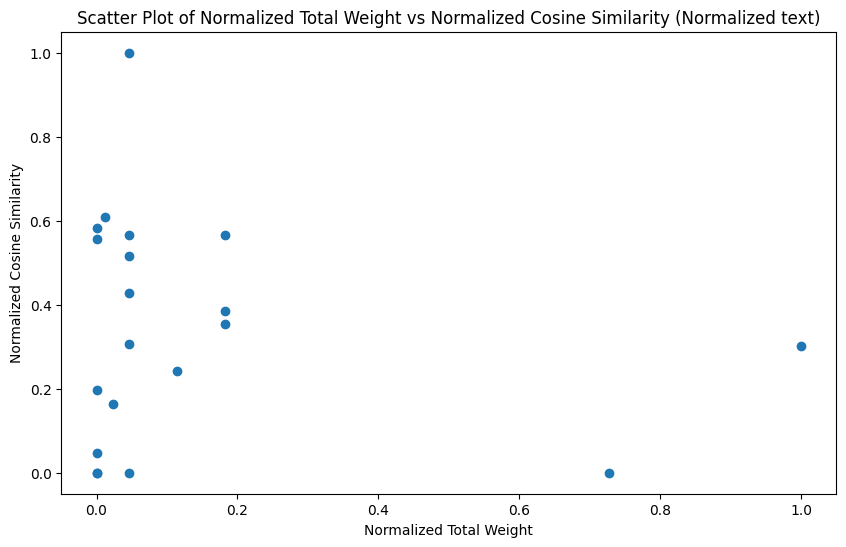

In [25]:
import matplotlib.pyplot as plt
# Separate the normalized values for plotting
edge_names = [item[0] for item in normalized_edge_data]
normalized_weights = [item[1] for item in normalized_edge_data]
normalized_cosine_similarities = [item[2] for item in normalized_edge_data]

# Create the scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(normalized_weights, normalized_cosine_similarities)

# Adding labels for each point

plt.xlabel('Normalized Total Weight')
plt.ylabel('Normalized Cosine Similarity')
plt.title('Scatter Plot of Normalized Total Weight vs Normalized Cosine Similarity (Normalized text)')
plt.show()


In [ ]:
# Analyzing interactions and pre-stored cosine similarities within class combinations
for combo in class_combinations:
    # Nodes in this combination
    nodes_in_combo = [node for node, data in G.nodes(data=True) 
                      if 'drug_classes' in data and set(combo).issubset(set(data['drug_classes']))]

    # Subgraph for this combination
    subgraph = G.subgraph(nodes_in_combo)

    #if subgraph.number_of_edges() > 0:
    

    # Aggregate cosine similarities from the edges
    cosine_similarities = [data['cosine_similarity'] for u, v, data in subgraph.edges(data=True)]
    if cosine_similarities:
        print(f"Analysis for class combination {combo}:")
        avg_similarity = sum(cosine_similarities) / len(cosine_similarities)
        print(f" - Average Cosine Similarity: {avg_similarity:.2f}")


In [ ]:
import matplotlib.pyplot as plt
import networkx as nx

# Assigning a color to each class
class_to_color = {cls: idx for idx, cls in enumerate(all_classes)}

# Color for each node based on its primary class
node_colors = []
for _, data in G.nodes(data=True):
    if 'drug_classes' in data and data['drug_classes']:
        # Use the first class in the list for coloring
        primary_class = data['drug_classes'][0]
        node_colors.append(class_to_color.get(primary_class, 0))
    else:
        # Default color for nodes without 'drug_classes' or with an empty list
        node_colors.append(0)

# Draw the graph
plt.figure(figsize=(12, 12))
nx.draw_networkx(G, node_color=node_colors, with_labels=False, node_size=50, edge_color='grey', cmap=plt.cm.tab20)
plt.show()


In [ ]:

# Specify the file path where you want to save the JSON file
output_file_path = 'scaled_pagerank_scores4.json'

# Open the file in write mode and use json.dump() to save the dictionary to the file
with open(output_file_path, 'w') as json_file:
    for drug, score in scaled_pagerank_scores.items():
        json_file.write(json.dumps({drug: score}) + '\n')


In [ ]:

# Specify the file path where you want to save the JSON file
output_file_path = 'scaled_between_scores2.json'

# Open the file in write mode and use json.dump() to save the dictionary to the file
with open(output_file_path, 'w') as json_file:
    for drug, score in scaled_eigenvector_centrality_scores.items():
        json_file.write(json.dumps({drug: score}) + '\n')